# Prophet predict market close price (1H)

In [4]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import tpqoa

In [14]:
# Load OANDA config file
api = tpqoa.tpqoa('oanda.cfg')

# Getting data
df = api.get_history("EUR_USD", "2014-01-01", "2024-04-15", "H1", "M")
df.to_csv('./data/EUR_USD_H1_2014_2024_M.csv', encoding='utf-8')

In [5]:
# Import data to use in Prophet
data = pd.read_csv('./data/EUR_USD_H1_2014_2024_M.csv', 
                   parse_dates = ['time'], index_col = 'time', 
                   usecols = ['time', 'c'])
symbol = 'EUR_USD'
data['ds'] = data.index
data['y'] = data['c']

In [6]:
data

,c,ds,y
time,,,
2014-01-01 22:00:00,1.37626,2014-01-01 22:00:00,1.37626
2014-01-01 23:00:00,1.37642,2014-01-01 23:00:00,1.37642
2014-01-02 00:00:00,1.37592,2014-01-02 00:00:00,1.37592
2014-01-02 01:00:00,1.37633,2014-01-02 01:00:00,1.37633
2014-01-02 02:00:00,1.37662,2014-01-02 02:00:00,1.37662
...,...,...,...
2024-04-12 19:00:00,1.06383,2024-04-12 19:00:00,1.06383
2024-04-12 20:00:00,1.06417,2024-04-12 20:00:00,1.06417
2024-04-14 21:00:00,1.06359,2024-04-14 21:00:00,1.06359


In [7]:
from prophet import Prophet
import copy
def prophet_signal(data, l, backcandles, frontpredictions, diff_limit, signal):
    datasplit = copy.deepcopy(data[l-backcandles:l+1])
    model = Prophet()
    model.fit(datasplit)
    future = model.make_future_dataframe(periods=frontpredictions, freq='H', include_history=False)
    forecast = model.predict(future)
    # if signal:
    forecast["y_target"] = data['y'].iloc[l+1:l+frontpredictions+1]
    forecast = forecast[['yhat', 'yhat_lower', 'yhat_upper']].values[0]
    return forecast[0], forecast[1], forecast[2]

Importing plotly failed. Interactive plots will not work.


In [8]:
from tqdm import tqdm
backcandles = 120
frontpredictions = 1
yhatlow = [0 for i in range(len(data))]
yhat = [0 for i in range(len(data))]
yhathigh = [0 for i in range(len(data))]

for row in tqdm(range(backcandles, len(data)-frontpredictions)):
    prophet_pred = prophet_signal(data, row, backcandles, frontpredictions=1, diff_limit=0.008, signal=False)
    yhatlow[row] = prophet_pred[0]
    yhat[row] = prophet_pred[1]
    yhathigh[row] = prophet_pred[2]

data['yhat'] = yhatlow
data['yhatlow'] = yhat
data['yhathigh'] = yhathigh

  0%|          | 0/63819 [00:00<?, ?it/s]

00:55:46 - cmdstanpy - INFO - Chain [1] start processing
00:55:46 - cmdstanpy - INFO - Chain [1] done processing
  0%|          | 1/63819 [00:00<2:47:25,  6.35it/s]00:55:46 - cmdstanpy - INFO - Chain [1] start processing
00:55:46 - cmdstanpy - INFO - Chain [1] done processing
  0%|          | 2/63819 [00:00<2:22:19,  7.47it/s]00:55:46 - cmdstanpy - INFO - Chain [1] start processing
00:55:46 - cmdstanpy - INFO - Chain [1] done processing
  0%|          | 3/63819 [00:00<2:11:47,  8.07it/s]00:55:46 - cmdstanpy - INFO - Chain [1] start processing
00:55:46 - cmdstanpy - INFO - Chain [1] done processing
  0%|          | 4/63819 [00:00<2:04:08,  8.57it/s]00:55:46 - cmdstanpy - INFO - Chain [1] start processing
00:55:46 - cmdstanpy - INFO - Chain [1] done processing
  0%|          | 5/63819 [00:00<2:07:31,  8.34it/s]00:55:46 - cmdstanpy - INFO - Chain [1] start processing
00:55:46 - cmdstanpy - INFO - Chain [1] done processing
00:55:46 - cmdstanpy - INFO - Chain [1] start processing
00:55:46 -

In [9]:
data['yhatlow'] = data['yhatlow'].shift(+1)
data['yhathigh'] = data['yhathigh'].shift(+1)
data['yhat'] = data['yhat'].shift(+1)

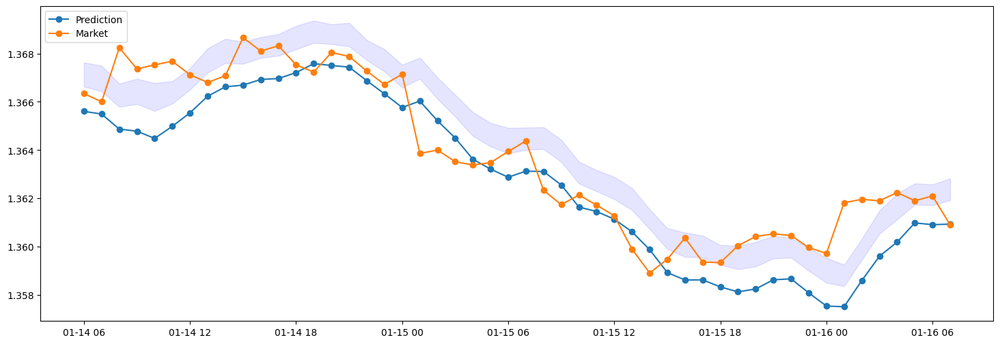

In [10]:
from matplotlib import pyplot as plt
x1 = 200
x2 = 250
plt.figure(figsize=(18,6))
plt.plot(data['ds'].iloc[x1:x2],data['yhatlow'].iloc[x1:x2], label="Prediction", marker='o')
plt.fill_between(data['ds'].iloc[x1:x2], data['yhat'].iloc[x1:x2], data['yhathigh'].iloc[x1:x2], color='b', alpha=.1)
plt.plot(data['ds'].iloc[x1:x2], data['y'].iloc[x1:x2], label = "Market", marker='o')
plt.legend(loc="upper left")


# Prophet predict market close price (1D)

In [11]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import tpqoa

In [13]:
# Load OANDA config file
api = tpqoa.tpqoa('oanda.cfg')

# Getting data
df = api.get_history("EUR_USD", "2005-01-01", "2024-04-15", "D1", "M")
df.to_csv('./data/EUR_USD_D1_2005_2024_M.csv', encoding='utf-8')

ResponseNoField: 400 response for GET https://api-fxpractice.oanda.com:443/v3/instruments/EUR_USD/candles?price=M&granularity=D1&from=2005-01-01T00%3A00%3A00.000000000Z&to=2024-04-15T00%3A00%3A00.000000000Z does not have field 'candles' (contains 'errorMessage')

# Prophet predict market using return log

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import tpqoa

In [5]:
# Import data to use in Prophet
data2 = pd.read_csv('./data/EUR_USD_H1_2014_2024_M.csv', 
                   parse_dates = ['time'], index_col = 'time', 
                   usecols = ['time', 'c'])
symbol = 'EUR_USD'
data2['ds'] = data2.index
# data2['y'] = data2['c']

# Calculate log returns
data2['returns'] = np.log(data2['c'] / data2['c'].shift())
data2['y'] = np.where(data2["returns"] > 0, 1, 0)

In [8]:
from prophet import Prophet
import copy
def prophet_signal(data, l, backcandles, frontpredictions, diff_limit, signal):
    datasplit = copy.deepcopy(data[l-backcandles:l+1])
    model = Prophet()
    model.fit(datasplit)
    future = model.make_future_dataframe(periods=frontpredictions, freq='H', include_history=False)
    forecast = model.predict(future)
    # if signal:
    forecast["y_target"] = data['y'].iloc[l+1:l+frontpredictions+1]
    forecast = forecast[['yhat', 'yhat_lower', 'yhat_upper']].values[0]
    return forecast[0], forecast[1], forecast[2]

In [10]:
from tqdm import tqdm
backcandles = 24
frontpredictions = 1
yhatlow = [0 for i in range(len(data2))]
yhat = [0 for i in range(len(data2))]
yhathigh = [0 for i in range(len(data2))]

for row in tqdm(range(backcandles, len(data2)-frontpredictions)):
    prophet_pred = prophet_signal(data2, row, backcandles, frontpredictions=1, diff_limit=0.008, signal=False)
    yhatlow[row] = prophet_pred[0]
    yhat[row] = prophet_pred[1]
    yhathigh[row] = prophet_pred[2]

data2['yhat'] = yhatlow
data2['yhatlow'] = yhat
data2['yhathigh'] = yhathigh

  0%|          | 0/63915 [00:00<?, ?it/s]20:50:56 - cmdstanpy - INFO - Chain [1] start processing
20:50:57 - cmdstanpy - INFO - Chain [1] done processing
  0%|          | 1/63915 [00:00<3:34:45,  4.96it/s]20:50:57 - cmdstanpy - INFO - Chain [1] start processing
20:50:57 - cmdstanpy - INFO - Chain [1] done processing
20:50:57 - cmdstanpy - INFO - Chain [1] start processing
20:50:57 - cmdstanpy - INFO - Chain [1] done processing
  0%|          | 3/63915 [00:00<1:57:47,  9.04it/s]20:50:57 - cmdstanpy - INFO - Chain [1] start processing
20:50:57 - cmdstanpy - INFO - Chain [1] done processing
20:50:57 - cmdstanpy - INFO - Chain [1] start processing
20:50:57 - cmdstanpy - INFO - Chain [1] done processing
  0%|          | 5/63915 [00:00<1:35:02, 11.21it/s]20:50:57 - cmdstanpy - INFO - Chain [1] start processing
20:50:57 - cmdstanpy - INFO - Chain [1] done processing
20:50:57 - cmdstanpy - INFO - Chain [1] start processing
20:50:57 - cmdstanpy - INFO - Chain [1] done processing
  0%|          

In [11]:
data2['yhatlow'] = data2['yhatlow'].shift(+1)
data2['yhathigh'] = data2['yhathigh'].shift(+1)
data2['yhat'] = data2['yhat'].shift(+1)

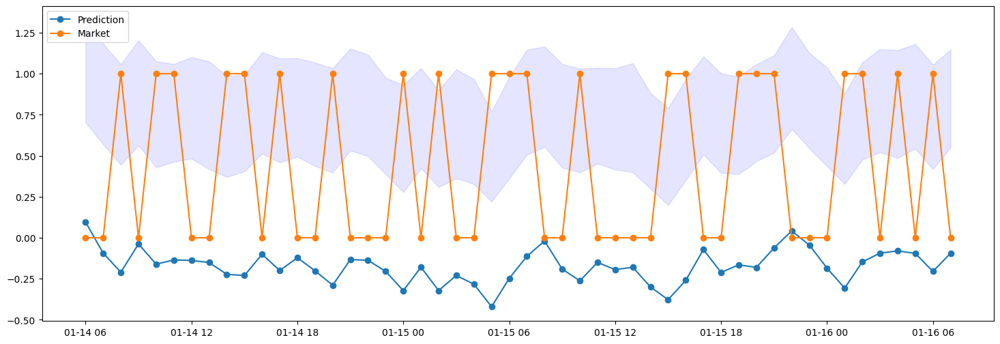

In [12]:
from matplotlib import pyplot as plt
x1 = 200
x2 = 250
plt.figure(figsize=(18,6))
plt.plot(data2['ds'].iloc[x1:x2],data2['yhatlow'].iloc[x1:x2], label="Prediction", marker='o')
plt.fill_between(data2['ds'].iloc[x1:x2], data2['yhat'].iloc[x1:x2], data2['yhathigh'].iloc[x1:x2], color='b', alpha=.1)
plt.plot(data2['ds'].iloc[x1:x2], data2['y'].iloc[x1:x2], label = "Market", marker='o')
plt.legend(loc="upper left")